# Extract Mechanisms from Space

## Setup Environment

In [1]:
import os
import numpy as np
import pandas as pd

import scanpy as sc
import liana as li

In [2]:
import sys
sys.path.append(os.path.join('..', 'spot_calling'))

In [3]:
from utils import load_prep_slide

In [4]:
data_dir = os.path.join('..', '..', 'data', 'heart_visium')

In [5]:
dataset_names = [f for f in os.listdir(data_dir) if f.endswith('.h5ad')]

In [6]:
metadata = pd.read_csv(os.path.join("..", "spot_calling", "visium_meta.csv"))

## Process Datasets

In [7]:
lrdatas = {}

In [8]:
for dataset_name in dataset_names:
    print(f"dataset_name: {dataset_name}")
    adata = load_prep_slide(data_dir, dataset_name, add_sample_name=True)
    adata.write_h5ad(os.path.join('results', 'processed', dataset_name))

    li.mt.lr_bivar(adata,
                    function_name='cosine',
                    expr_prop=0.1,
                    pvalue_method=None,
                    use_raw=False,
                    add_categories=True,
                    )
    lrdata = li.fun.obsm_to_adata(adata, 'local_scores')
    # lrdata.layers['raw'] = lrdata.X.copy()
    local_cats = li.fun.obsm_to_adata(adata, 'local_cats')
    
    # keep hotspots positive only
    # lrdata.X[local_cats.X <= 0] = 0
    
    # shape
    print(f"lrdata shape: {lrdata.shape}")

    lrdatas[dataset_name] = lrdata


dataset_name: AKK001_157785.h5ad
lrdata shape: (3082, 500)
dataset_name: AKK002_157779.h5ad
lrdata shape: (3771, 674)
dataset_name: AKK002_157781.h5ad
lrdata shape: (4659, 651)
dataset_name: AKK002_157782.h5ad
lrdata shape: (2994, 739)
dataset_name: AKK003_157775.h5ad
lrdata shape: (4200, 601)
dataset_name: AKK003_157777.h5ad
lrdata shape: (3373, 498)
dataset_name: AKK004_157772.h5ad
lrdata shape: (4104, 217)
dataset_name: AKK006_157771.h5ad
lrdata shape: (4267, 374)
dataset_name: Visium_10_CK288.h5ad
lrdata shape: (3388, 384)
dataset_name: Visium_11_CK289.h5ad
lrdata shape: (1857, 679)
dataset_name: Visium_12_CK290.h5ad
lrdata shape: (3173, 490)
dataset_name: Visium_13_CK291.h5ad
lrdata shape: (2494, 362)
dataset_name: Visium_14_CK292.h5ad
lrdata shape: (3084, 416)
dataset_name: Visium_15_CK293.h5ad
lrdata shape: (2679, 732)
dataset_name: Visium_16_CK294.h5ad
lrdata shape: (2406, 350)
dataset_name: Visium_17_CK295.h5ad
lrdata shape: (3484, 582)
dataset_name: Visium_18_CK296.h5ad
lrdat

## Run NMF on the whole Dataset

In [9]:
from sklearn.decomposition import NMF
from matplotlib import pyplot as plt

In [10]:
features = pd.concat([lrdatas[dataset_name].var for dataset_name in lrdatas])
features['count'] = 1 
features = features.reset_index().groupby('interaction').sum().sort_values('count')

<AxesSubplot:>

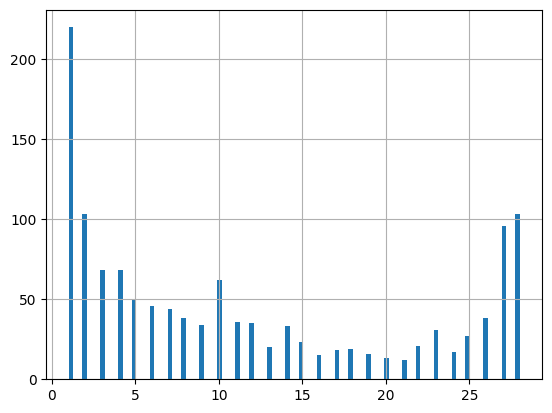

In [11]:
features['count'].hist(bins=100)

Keep features in at least 10 samples (~1/3rds of the datasets)

In [12]:
features = features[features['count'] >= 10]

In [13]:
features.index

Index(['PGF&NRP2', 'LAMA2&ITGA3_ITGB1', 'ST6GAL1&EGFR', 'COL4A2&ITGA3_ITGB1',
       'CCN2&EGFR', 'TGFB1&TGFBR1_TGFBR2', 'PLAU&PLAUR', 'LAMA4&ITGA3_ITGB1',
       'CXCL12&CXCR4', 'HGF&SDC2',
       ...
       'PSAP&LRP1', 'COL4A2&CD93', 'COL1A2&CD93', 'TGM2&ITGB1', 'COL1A2&CD36',
       'COL1A1&ITGA5', 'COL1A1&CD93', 'COL1A1&CD36', 'COL4A1&CD93',
       'A2M&LRP1'],
      dtype='object', name='interaction', length=635)

In [14]:
lrdata_all = sc.concat(lrdatas, join='outer', fill_value=0)

In [15]:
lrdata_all

AnnData object with n_obs × n_vars = 91205 × 1306
    obs: 'in_tissue', 'array_row', 'array_col', 'sample', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'mt_frac', 'celltype_niche', 'molecular_niche', 'n_genes'
    obsm: 'compositions', 'mt', 'spatial', 'local_scores', 'local_cats'

In [16]:
# subset to features found in at least 10 datasets
lrdata_all = lrdata_all[:, features.index]

In [17]:
lrdata_all

View of AnnData object with n_obs × n_vars = 91205 × 635
    obs: 'in_tissue', 'array_row', 'array_col', 'sample', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'mt_frac', 'celltype_niche', 'molecular_niche', 'n_genes'
    obsm: 'compositions', 'mt', 'spatial', 'local_scores', 'local_cats'

UMAP + Leiden

In [18]:
# lrdata_all.layers['cosine'] = lrdata_all.X.copy()
# sc.pp.scale(lrdata_all, max_value=10)
# sc.tl.pca(lrdata_all, n_comps=30)
# sc.pl.pca_variance_ratio(lrdata_all, log=True)
# sc.pp.neighbors(lrdata_all, n_neighbors=10, n_pcs=20)
# sc.tl.leiden(lrdata_all, resolution=0.5)
# sc.tl.umap(lrdata_all)
# sc.pl.umap(lrdata_all, color=['leiden', 'molecular_niche', 'batch', 'patient', 'patient_group'], ncols=2)

### Estimate Optimal Factor N

In [19]:
X = lrdata_all.X
# from sklearn.preprocessing import MinMaxScaler
# scaler = MinMaxScaler()
# X = scaler.fit_transform(lrdata_all.X)

In [20]:
def calculate_reconstruction_error(X, n):
    model = NMF(n_components=n, random_state=0, max_iter=200)  # Create NMF model
    W = model.fit_transform(X)  # Compute NMF decomposition
    H = model.components_
    Xhat = np.dot(W, H)
    error = np.mean(np.sqrt((X - Xhat) ** 2))  # Reconstruction error
    return error


In [21]:
n_values = range(1, 15)

In [22]:
errors = []
for n in n_values:
    error = calculate_reconstruction_error(X, n)  # X is your input data
    errors.append(error)


/home/dbdimitrov/anaconda3/envs/spiana/lib/python3.10/site-packages/sklearn/decomposition/_nmf.py:1665: ConvergenceWarning: Maximum number of iterations 200 reached. Increase it to improve convergence.
/home/dbdimitrov/anaconda3/envs/spiana/lib/python3.10/site-packages/sklearn/decomposition/_nmf.py:1665: ConvergenceWarning: Maximum number of iterations 200 reached. Increase it to improve convergence.
/home/dbdimitrov/anaconda3/envs/spiana/lib/python3.10/site-packages/sklearn/decomposition/_nmf.py:1665: ConvergenceWarning: Maximum number of iterations 200 reached. Increase it to improve convergence.
/home/dbdimitrov/anaconda3/envs/spiana/lib/python3.10/site-packages/sklearn/decomposition/_nmf.py:1665: ConvergenceWarning: Maximum number of iterations 200 reached. Increase it to improve convergence.
/home/dbdimitrov/anaconda3/envs/spiana/lib/python3.10/site-packages/sklearn/decomposition/_nmf.py:1665: ConvergenceWarning: Maximum number of iterations 200 reached. Increase it to improve con

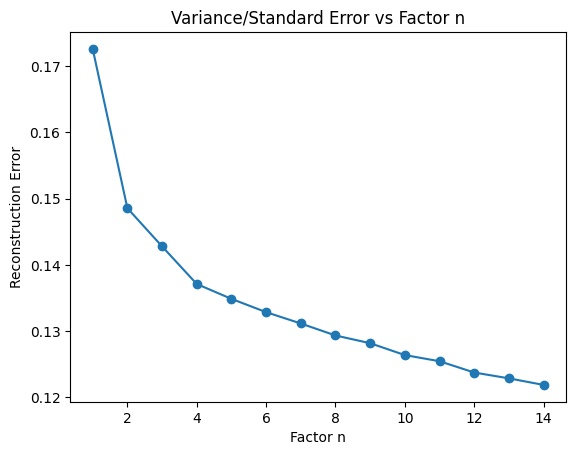

In [23]:
plt.plot(n_values, errors, marker='o')
plt.xlabel('Factor n')
plt.ylabel('Reconstruction Error')
plt.title('Variance/Standard Error vs Factor n')
plt.show()

### NMF

In [24]:
# Create an instance of the NMF class
model = NMF(n_components=4, init='random', random_state=0)

In [25]:
# Fit the model to the data and obtain the factorized matrices
W = model.fit_transform(lrdata_all.X)
H = model.components_

/home/dbdimitrov/anaconda3/envs/spiana/lib/python3.10/site-packages/sklearn/decomposition/_nmf.py:1665: ConvergenceWarning: Maximum number of iterations 200 reached. Increase it to improve convergence.


In [26]:
 ## NOTE take index from adata.obs.index, not from the obsm matrix
columns = [f"Factor{i+1}" for i in range(W.shape[1])]

In [27]:
lrdata_all.obsm['NMF_W'] = pd.DataFrame(W, index=lrdata_all.obs.index, columns=columns)
lrdata_all.varm['NMF_H'] = H.T # NOTE I don't convert to dataframe, because it does not get filtered

In [28]:
metadata['patient_group'] =  metadata['patient_group'].replace({'group_1': 'Myogenic\n(n=14)', 'group_2': 'Ischemic\n(n=9)', 'group_3': 'Fibrotic\n(n=5)'})

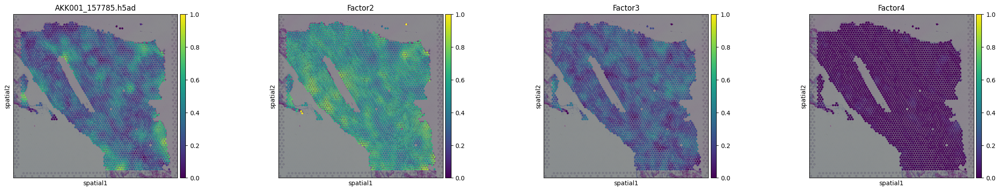

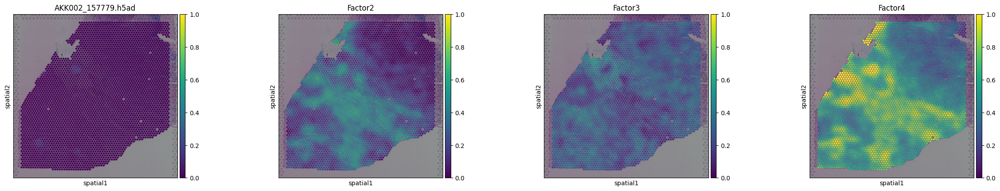

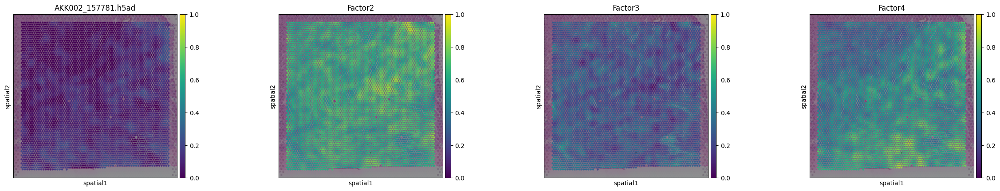

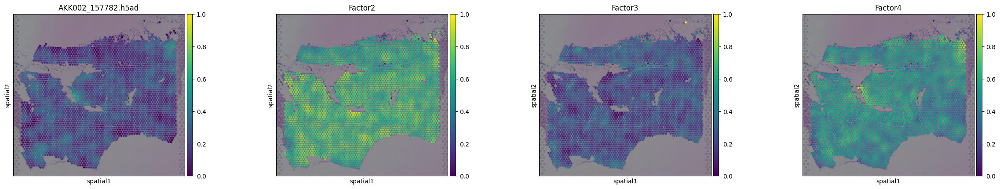

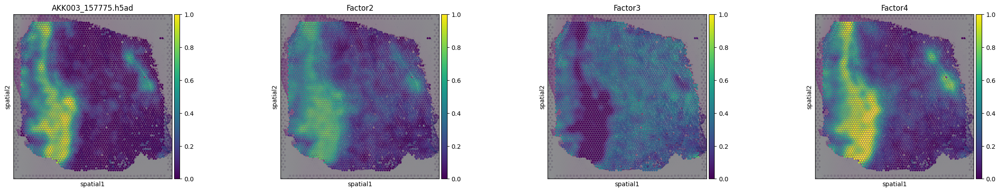

...

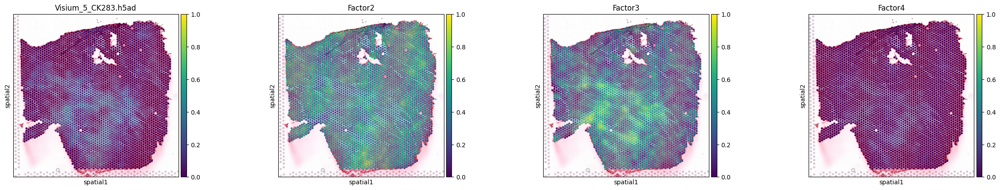

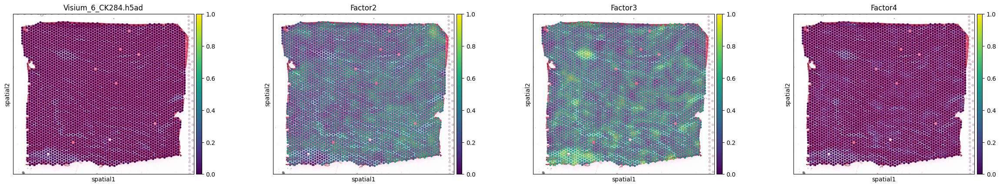

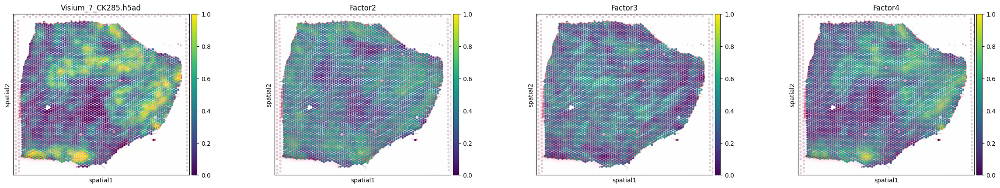

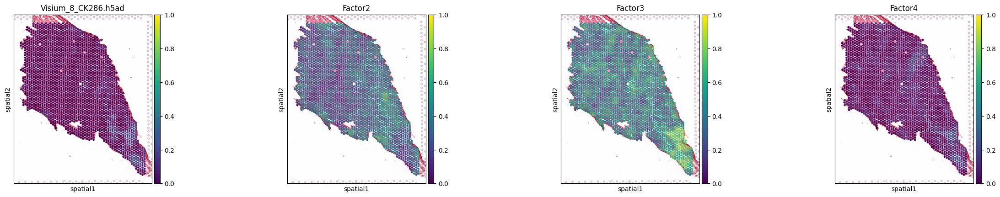

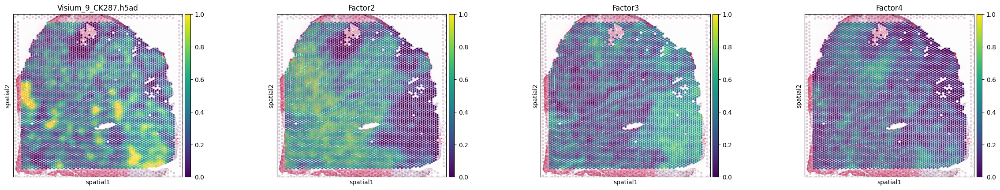

In [29]:
# transfer the NMF factors to the individual samples
for sample in lrdatas:
    # each
    lrdata = lrdatas[sample]
    
    # save to folder
    lrdata.write_h5ad(os.path.join('results', 'lr', sample))
    
    # Get the NMF factors for the current sample from the full dataset
    temp = lrdata_all[lrdata_all.obs.index.isin(lrdata.obs.index), :]
    temp = temp[:, temp.var.index.isin(lrdata.var.index)]
    
    # extract from obsm
    ## TODO need to figure out how to handle .obsm & .uns - they keep getting copied over
    ad_nmf = li.fun.obsm_to_adata(temp, obsm_key='NMF_W', _uns=lrdata.uns)
    ad_nmf.write_h5ad(os.path.join('results', 'nmf', sample))
    
    # plot
    sc.pl.spatial(ad_nmf, color=temp.obsm['NMF_W'].columns, cmap='viridis', title=sample, vmax=1, vmin=0, size=1.3) # 

### Analyse Loadings

In [30]:
nmfdata = li.fun.obsm_to_adata(lrdata_all, 'NMF_W')

In [31]:
indices = lrdata_all.obs.index
nmfdata.obs = nmfdata.obs.merge(metadata, left_on='sample', right_on='slide_name')
nmfdata.obs.index = indices

/home/dbdimitrov/anaconda3/envs/spiana/lib/python3.10/site-packages/anndata/_core/anndata.py:798: UserWarning: 
AnnData expects .obs.index to contain strings, but got values like:
    [0, 1, 2, 3, 4]

    Inferred to be: integer



Averages per slide

In [32]:
import decoupler as dc

In [33]:
import seaborn as sns

In [34]:
nmfbulk = dc.get_pseudobulk(nmfdata,
                            sample_col='hca_sample_id',
                            groups_col=None, mode='mean',
                            skip_checks=True, min_cells=0,
                            min_counts=0, min_prop=None,
                            min_smpls=None)

In [35]:
group_annotations = nmfbulk.obs['patient_group'].values

In [36]:
group_labels = set(group_annotations)

In [37]:
group_labels

{'Fibrotic\n(n=5)', 'Ischemic\n(n=9)', 'Myogenic\n(n=14)'}

In [38]:
# import colour map Dark2 from seaborn
cmap = sns.color_palette('Dark2', n_colors=len(group_labels))

In [39]:
# get cmap values for each group annotation as hex
group_cmap = dict(zip(group_labels, cmap))

In [40]:
group_cols = [group_cmap[key] for key in group_labels]

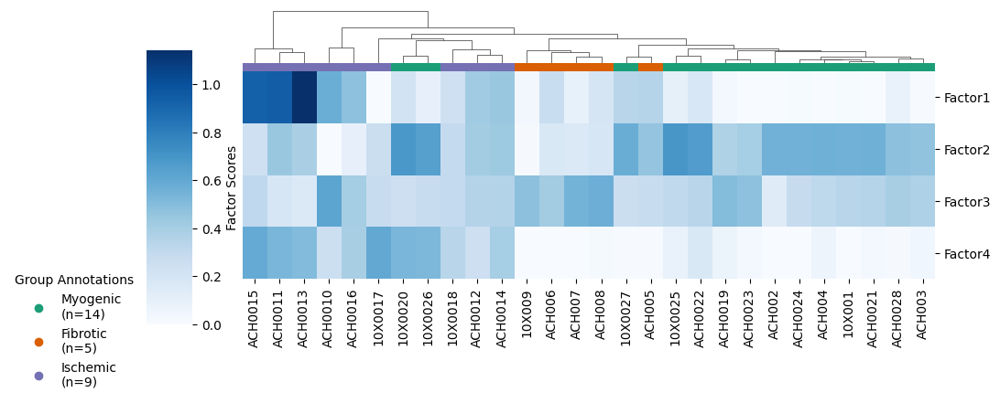

In [41]:
chart = sns.clustermap(nmfbulk.X.T,
                       cmap='Blues',
                       cbar_kws={'label':'Factor Scores', 'orientation':'vertical'},
                       row_cluster=False, col_cluster=True,
                       col_colors=[group_cmap[x] for x in group_annotations],
                       # change size
                       figsize=(10, 4),
                       # add x axis label
                       xticklabels=nmfbulk.obs.index,
                       yticklabels=nmfbulk.var.index,
                       cbar_pos=(0.1, 0.1, 0.05, 0.75)
                       )
# rotate labels
chart.ax_heatmap.set_yticklabels(chart.ax_heatmap.get_ymajorticklabels(), rotation=0)
colorbar = chart.ax_col_colors.collections[0].colorbar

# Create custom legend
legend_handles = []
for label, color in zip(group_labels, group_cols):
    legend_handles.append(plt.Line2D([0], [0], color=color, marker='o', linestyle='', label=label))

# Add legend
legend = plt.legend(handles=legend_handles, title='Group Annotations', loc='upper right', frameon=False)

# Move the legend
chart_size = chart.ax_heatmap.get_position()
plt.setp(legend.get_title(), fontsize='medium')  # Set the font size of the legend title
legend.set_bbox_to_anchor((chart_size.x1 - 1, chart_size.y0))  # Adjust the position of the legend
plt.show()

Two factors associated with Ischemic: Factor1 and Factor4; Factor2 healthy; Factor 3 kinda mixed

In [42]:
nmfdata.obs[['hca_sample_id', 'patient', 'sample']].drop_duplicates()

,hca_sample_id,patient,sample
AKK001_157785-AAACAAGTATCTCCCA-1,10X0027,P5,AKK001_157785
AKK002_157779-AAACAAGTATCTCCCA-1,10X0017,P3,AKK002_157779
AKK002_157781-AAACAACGAATAGTTC-1,10X0026,P3,AKK002_157781
AKK002_157782-AAACAAGTATCTCCCA-1,10X0020,P3,AKK002_157782
AKK003_157775-AAACAACGAATAGTTC-1,10X0018,P2,AKK003_157775
AKK003_157777-AAACAAGTATCTCCCA-1,10X0025,P2,AKK003_157777
AKK004_157772-AAACAACGAATAGTTC-1,10X009,P4,AKK004_157772
AKK006_157771-AAACAAGTATCTCCCA-1,10X001,P1,AKK006_157771
Visium_10_CK288-AAACAAGTATCTCCCA-1,ACH0024,P12,Visium_10_CK288
Visium_11_CK289-AAACAAGTATCTCCCA-1,ACH0010,P13,Visium_11_CK289


### Pathway Enrichment

In [43]:
import plotnine as p9
# fdr adjust pvals
from statsmodels.stats.multitest import fdrcorrection as fdr

In [44]:
lr_nmf = pd.DataFrame(lrdata_all.varm['NMF_H'], index=lrdata_all.var.index, columns=columns)

In [45]:
lr_nmf.to_csv(os.path.join('results', 'lr_loadings.csv'))

In [46]:
lr_nmf.sort_values("Factor4", ascending=False).head(5)

,Factor1,Factor2,Factor3,Factor4
interaction,,,,
SPP1&ITGA5_ITGB1,0.004231,0.000000,0.147868,1.070936
SPP1&CD44,0.015882,0.000000,0.248751,1.004340
SPP1&ITGAV_ITGB1,0.086530,0.000000,0.189784,1.001158
TNC&ITGA5,0.027910,0.051753,0.094786,0.974601
NAMPT&ITGA5_ITGB1,0.000000,0.234784,0.328909,0.960763


In [47]:
# load PROGENy pathways
net = dc.get_progeny(organism='human', top=5000)
# load full list of ligand-receptor pairs
lr_pairs = li.resource.select_resource('consensus')


/home/dbdimitrov/anaconda3/envs/spiana/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html


In [48]:
# generate ligand-receptor geneset
lr_progeny = li.fun.generate_lr_geneset(lr_pairs, net, lr_separator="&")
lr_progeny.head()

,source,interaction,weight
1,JAK-STAT,LGALS9&PTPRC,1.307807
74,Androgen,SEMA4D&MET,-0.831693
90,Androgen,HGF&MET,-1.288956
106,Androgen,TIMP3&MET,-1.122612
151,NFkB,SELE&CD44,3.332552


In [49]:
# run pathway enrichment analysis
estimate, pvals =  dc.run_ulm(lr_nmf.transpose(),
                              lr_progeny,
                              source="source", target="interaction",
                              use_raw=False, min_n=5)
# pivot columns to long
estimate = (estimate.
            melt(ignore_index=False, value_name='estimate', var_name='pathway').
            reset_index().
            rename(columns={'index':'factor'})
            )
# pivot columns to long
pvals = (pvals.
            melt(ignore_index=False, value_name='pval', var_name='pathway').
            reset_index().
            rename(columns={'index':'factor'})
        )

In [50]:
dc_res = estimate.merge(pvals, on=['factor', 'pathway']).copy()

In [51]:
dc_res.loc[dc_res['estimate'] >= 5, 'estimate'] = 5

In [52]:
dc_res['adj_pval'] = fdr(dc_res['pval'])[1]

In [53]:
dc_res.sort_values('adj_pval').head()

,factor,pathway,estimate,pval,adj_pval
32,Factor1,TGFb,5.000000,3.280075e-15,1.836842e-13
39,Factor4,TNFa,5.000000,4.676633e-07,8.729716e-06
23,Factor4,MAPK,5.000000,4.493863e-07,8.729716e-06
7,Factor4,EGFR,4.990711,7.784588e-07,1.089842e-05
24,Factor1,NFkB,-4.669795,3.683478e-06,4.125496e-05


In [54]:
# assign * if adj_pval < 0.05
dc_res['significant'] = dc_res['adj_pval'].apply(lambda x: '*' if x < 0.05 else '')

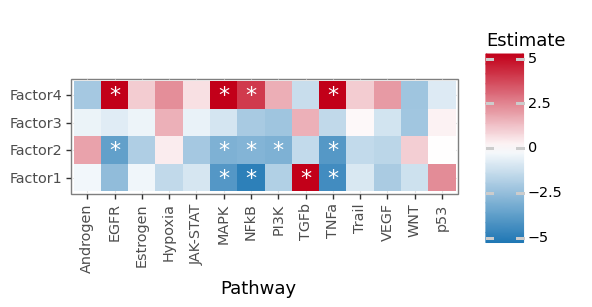

<ggplot: (8792132576887)>

In [66]:
## p9 tile plot
(p9.ggplot(dc_res) +
 p9.aes(x='pathway', y='factor') +
 p9.geom_tile(p9.aes(fill='estimate')) +
 # geom text significant
 p9.geom_text(p9.aes(label='significant'), size=14, color='white', fontstyle='oblique') +
 p9.theme_bw(base_size=13) +
 p9.theme(figure_size=(5, 1.5), axis_text_x=p9.element_text(angle=90)) +
 # max 5 and min -5
 p9.scale_fill_gradient2(low='#1f77b4', high='#c20019', limits=(-5, 5)) +
 p9.labs(x='Pathway', y='', fill='Estimate')
)

Explore loadings x PROGENy, for a specific view

In [56]:
# pivot to long
lr_loadings = lr_nmf.melt(ignore_index=False, value_name='loading', var_name='factor').reset_index()

In [57]:
lr_loadings.rename(columns={'variable':'interaction'}, inplace=True)

In [58]:
lr_loadings

,interaction,factor,loading
0,PGF&NRP2,Factor1,0.171113
1,LAMA2&ITGA3_ITGB1,Factor1,0.052443
2,ST6GAL1&EGFR,Factor1,0.127069
3,COL4A2&ITGA3_ITGB1,Factor1,0.038367
4,CCN2&EGFR,Factor1,0.270145
...,...,...,...
2535,COL1A1&ITGA5,Factor4,0.682443
2536,COL1A1&CD93,Factor4,0.618066
2537,COL1A1&CD36,Factor4,0.234674
2538,COL4A1&CD93,Factor4,0.728444


In [59]:
lr_loadings = lr_loadings.merge(lr_progeny.rename(columns={"source":"pathway"}), left_on='interaction', right_on='interaction', how='left').dropna()

In [60]:
lr_loadings['sign'] = lr_loadings['weight'].apply(lambda x: 'positive' if x > 0 else 'negative')

In [61]:
lr_loadings['relevant_interactions'] = lr_loadings.apply(lambda x: x['interaction'] if (np.abs(x['loading']) > 0.3) and (np.abs(x['weight']) >= 2) else None, axis=1)

In [62]:
selected_pathway = 'TNFa'
selected_view = 'Factor4'

In [63]:
data = lr_loadings[(lr_loadings['pathway']==selected_pathway) & (lr_loadings['factor']==selected_view)].copy()

/home/dbdimitrov/anaconda3/envs/spiana/lib/python3.10/site-packages/plotnine/layer.py:411: PlotnineWarning: geom_label : Removed 19 rows containing missing values.


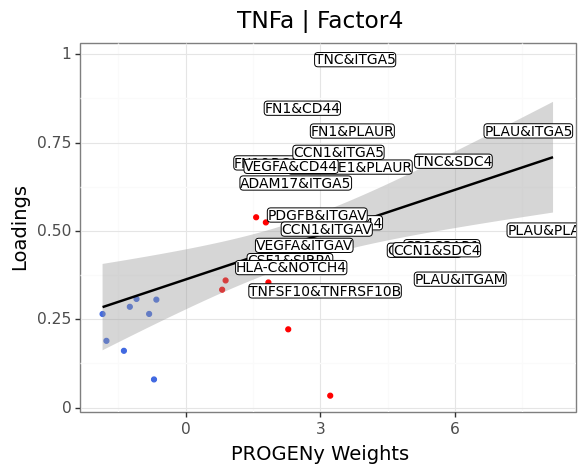

<ggplot: (8792137490372)>

In [64]:

(
    p9.ggplot(data) +
    p9.aes(x='weight', y='loading') +
    p9.geom_point(p9.aes( colour='sign')) +
    p9.theme(legend_position='none') +
    p9.labs(title="{} | {}".format(selected_pathway, selected_view), x="PROGENy Weights", y="Loadings") +
    p9.geom_smooth(method='lm') +
    p9.theme_bw(base_size=14) +
    p9.scale_colour_manual(values=["royalblue", "red"]) +
    p9.geom_label(p9.aes(label='relevant_interactions'), size=10, nudge_y=0.01, nudge_x=0.01, label_padding=0.01) +
    # p9.xlim(-3, 3) +
    p9.guides(colour=False)   
)